Continuation of [Pandas Hurricane Data Download](./PandasHurricaneDataDownload.ipynb)
<br>This notebook has:
1. Standard Deviation of both Track and Intensity by Decade
2. <del>Max error by year (is the beggest error decreasing over time?)<del/>
3. Spatial aspect of track and intensity error variability (using cartopy)

# Import NHCFV1 dataset

In [296]:
import numpy as np
import pandas as pd

NHCFV1=pd.read_csv('1970-present_OFCL_v_BCD5_ind_ATL_TI_errors_noTDs.txt', sep='\s+', engine='python')
print(NHCFV1) 
#after copy/pasting textfile into a seperate tab in jupyter notebook:
# code: label=pd.read_csv('filename.txt', sep='\s+', engine='python')
#sep= is the seperator field. /s+ and engine='python' is to avoid an error code of text files 
#with a ridiculous amount of columns

                 Date/Time     STMID  F012  F024  F036  F048  F072  F096  \
0      20-05-1970/00:00:00  AL011970  0.00  0.00  0.00  0.00  0.00  0.00   
1      20-05-1970/06:00:00  AL011970  0.00  0.00  0.00  0.00  0.00  0.00   
2      20-05-1970/12:00:00  AL011970  0.00  0.00  0.00  0.00  0.00  0.00   
3      20-05-1970/18:00:00  AL011970  1.00  1.00  0.00  0.00  0.00  0.00   
4      21-05-1970/00:00:00  AL011970  0.33  0.33  0.00  0.00  0.00  0.00   
5      21-05-1970/06:00:00  AL011970  0.33  0.00  0.00  0.00  0.00  0.00   
6      21-05-1970/12:00:00  AL011970  0.33  0.00  0.00  0.00  0.00  0.00   
7      21-05-1970/18:00:00  AL011970  0.00  0.00  0.00  0.00  0.00  0.00   
8      22-05-1970/00:00:00  AL011970  0.00  0.00  0.00  0.00  0.00  0.00   
9      20-07-1970/12:00:00  AL021970  1.00  1.00  0.00  0.00  0.00  0.00   
10     20-07-1970/18:00:00  AL021970  0.33  0.33  0.00  0.00  0.00  0.00   
11     21-07-1970/00:00:00  AL021970  0.33  0.33  0.00  0.00  0.00  0.00   
12     21-07

# Making Individual Dataset

## Track

In [43]:
#df that is just the track hours and date/time column
track_data=NHCFV1[["Lat","Lon","000hT01", "024hT01","048hT01", "072hT01", "096hT01", "120hT01", "144hT01"]]
track_data

,Lat,Lon,000hT01,024hT01,048hT01,072hT01,096hT01,120hT01,144hT01
0,15.5,82.5,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
1,16.2,82.3,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
2,16.8,81.9,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
3,17.2,81.6,42.4,145.4,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
4,18.0,81.0,49.6,139.7,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
...,...,...,...,...,...,...,...,...,...
11152,31.5,46.4,6.0,37.2,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
11153,33.5,44.4,5.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
11154,35.2,41.7,0.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
11155,36.6,38.5,11.4,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0


In [44]:
#getting rid of the -9999.0s
track_data=track_data.where(track_data>-9999.0)
track_data

,Lat,Lon,000hT01,024hT01,048hT01,072hT01,096hT01,120hT01,144hT01
0,15.5,82.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,16.2,82.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,16.8,81.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,17.2,81.6,42.4,145.4,NaN,NaN,NaN,NaN,NaN
4,18.0,81.0,49.6,139.7,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
11152,31.5,46.4,6.0,37.2,NaN,NaN,NaN,NaN,NaN
11153,33.5,44.4,5.0,NaN,NaN,NaN,NaN,NaN,NaN
11154,35.2,41.7,0.0,NaN,NaN,NaN,NaN,NaN,NaN
11155,36.6,38.5,11.4,NaN,NaN,NaN,NaN,NaN,NaN


In [45]:
#Shifting Longitude

# convert from degrees west to degrees east by 
# multiplying by -1 as 10 W is identical to -10 E

track_data["Lon"] = track_data["Lon"]* -1 

# track_data=track_data.drop(axis=1, columns=["lon"])
track_data

,Lat,Lon,000hT01,024hT01,048hT01,072hT01,096hT01,120hT01,144hT01
0,15.5,-82.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,16.2,-82.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,16.8,-81.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,17.2,-81.6,42.4,145.4,NaN,NaN,NaN,NaN,NaN
4,18.0,-81.0,49.6,139.7,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
11152,31.5,-46.4,6.0,37.2,NaN,NaN,NaN,NaN,NaN
11153,33.5,-44.4,5.0,NaN,NaN,NaN,NaN,NaN,NaN
11154,35.2,-41.7,0.0,NaN,NaN,NaN,NaN,NaN,NaN
11155,36.6,-38.5,11.4,NaN,NaN,NaN,NaN,NaN,NaN


## Intensity

In [195]:
#df that is just the track hours and date/time column
int_data=NHCFV1[["Lat","Lon","000hI01", "024hI01","048hI01", "072hI01", "096hI01", "120hI01", "144hI01"]]
int_data

,Lat,Lon,000hI01,024hI01,048hI01,072hI01,096hI01,120hI01,144hI01
0,15.5,82.5,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
1,16.2,82.3,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
2,16.8,81.9,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
3,17.2,81.6,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
4,18.0,81.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
5,18.2,80.3,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
6,18.5,80.2,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
7,19.0,80.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
8,19.6,80.1,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0
9,23.3,86.4,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0,-9999.0


In [196]:
#getting rid of the -9999.0s
int_data=int_data.where(int_data>-9999.0).abs()
int_data

,Lat,Lon,000hI01,024hI01,048hI01,072hI01,096hI01,120hI01,144hI01
0,15.5,82.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,16.2,82.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,16.8,81.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,17.2,81.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,18.0,81.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,18.2,80.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,18.5,80.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,19.0,80.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,19.6,80.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,23.3,86.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [197]:
#Shifting Longitude

# convert from degrees west to degrees east by 
# multiplying by -1 as 10 W is identical to -10 E

int_data["Lon"] = int_data["Lon"]* -1 

# track_data=track_data.drop(axis=1, columns=["lon"])
int_data

,Lat,Lon,000hI01,024hI01,048hI01,072hI01,096hI01,120hI01,144hI01
0,15.5,-82.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,16.2,-82.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,16.8,-81.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,17.2,-81.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,18.0,-81.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,18.2,-80.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,18.5,-80.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,19.0,-80.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,19.6,-80.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,23.3,-86.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Location w/ Cartopy

Cartopy plot instructions from [NCAR's YouTube Series](https://www.youtube.com/watch?v=ivmd3RluMiw)
<b>Code in the [Series Github](https://github.com/michaelavs/cartopy_tutorial/blob/main/cartopy_tutorial.ipynb)

## 1. Import Cartopy

In [297]:
import cartopy

# Import packages all from GitHub repository
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.ticker as mticker


## 2. Simple Plots w/ Different Projections

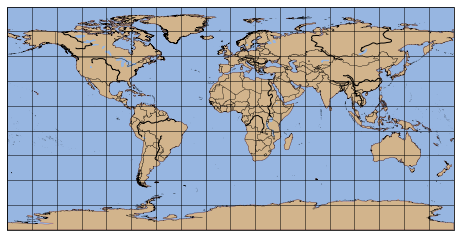

In [27]:
## Base code from tutorial

# Create and define the size of a figure object 
plt.figure(figsize=(8, 8))

# Create an axis with an basic PlateCarree projection style
ax=plt.axes(projection=ccrs.PlateCarree())

# Use different map projections 

# A full list of cartopy map projections can be found here: https://scitools.org.uk/cartopy/docs/latest/crs/projections.html
# Add natural features to map using cartopy.feature (cfeature)
ax.add_feature(cfeature.LAND, edgecolor="brown", facecolor="tan", linewidth=.2, zorder=0) #zorder makes sure everything is plotted in the correct order
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.RIVERS, edgecolor="black", facecolor="black")
ax.add_feature(cfeature.LAKES)

# Add border lines over countries 
ax.add_feature(cfeature.NaturalEarthFeature(category="cultural", #cultural category means borders since it isnt a natural thing
                                           name= "admin_0_countries", 
                                           scale="10m",  #scale tells cartopy what natural resolution we want 10m (millions of units) most refined
                                           facecolor="none",
                                           edgecolor="black",
                                           linewidth=.2))
#category is a preloaded datasource in cartopy



# Add lat/lon gridlines ->Draw gridlines 
gl=ax.gridlines(crs=ccrs.PlateCarree(),linewidth=1, color="black", alpha=0.5) #crs=cordinate reference system

# Manipulate latitude and longitude gridline numbers and spacing
gl.ylocator=mticker.FixedLocator(np.arange(-90,90,20)) #-90 = 90 south, 90 north, increments of 20)
gl.xlocator=mticker.FixedLocator(np.arange(-180,180,20)) #180 = 180 west, 180 west north, increments of 20)



# For a list of available features in NaturalEarthFeature visit: https://www.naturalearthdata.com/features/

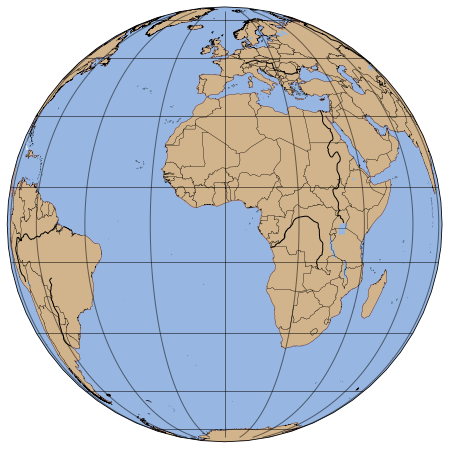

In [35]:
## Base code from tutorial # Use different map projections 


# Create and define the size of a figure object 
plt.figure(figsize=(8, 8))

# Create an axis with an basic PlateCarree projection style
ax=plt.axes(projection=ccrs.Orthographic())


# A full list of cartopy map projections can be found here: https://scitools.org.uk/cartopy/docs/latest/crs/projections.html
# Add natural features to map using cartopy.feature (cfeature)
ax.add_feature(cfeature.LAND, edgecolor="brown", facecolor="tan", linewidth=.2, zorder=0) #zorder makes sure everything is plotted in the correct order
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.RIVERS, edgecolor="black", facecolor="black")
ax.add_feature(cfeature.LAKES)

# Add border lines over countries 
ax.add_feature(cfeature.NaturalEarthFeature(category="cultural", #cultural category means borders since it isnt a natural thing
                                           name= "admin_0_countries", 
                                           scale="10m",  #scale tells cartopy what natural resolution we want 10m (millions of units) most refined
                                           facecolor="none",
                                           edgecolor="black",
                                           linewidth=.2))
#category is a preloaded datasource in cartopy



# Add lat/lon gridlines ->Draw gridlines 
gl=ax.gridlines(crs=ccrs.PlateCarree(),linewidth=1, color="black", alpha=0.5) #crs=cordinate reference system

# Manipulate latitude and longitude gridline numbers and spacing
gl.ylocator=mticker.FixedLocator(np.arange(-90,90,20)) #-90 = 90 south, 90 north, increments of 20)
gl.xlocator=mticker.FixedLocator(np.arange(-180,180,20)) #180 = 180 west, 180 west north, increments of 20)



# For a list of available features in NaturalEarthFeature visit: https://www.naturalearthdata.com/features/

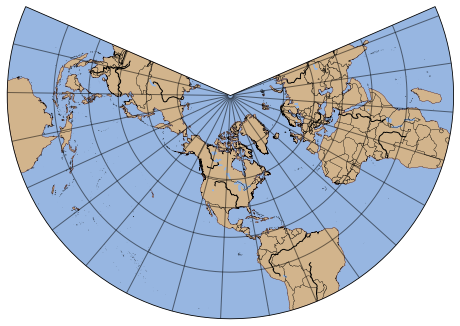

In [36]:
## Base code from tutorial

# Create and define the size of a figure object 
plt.figure(figsize=(8, 8))

# Create an axis with an basic PlateCarree projection style
ax=plt.axes(projection=ccrs.LambertConformal())

# Use different map projections 

# A full list of cartopy map projections can be found here: https://scitools.org.uk/cartopy/docs/latest/crs/projections.html
# Add natural features to map using cartopy.feature (cfeature)
ax.add_feature(cfeature.LAND, edgecolor="brown", facecolor="tan", linewidth=.2, zorder=0) #zorder makes sure everything is plotted in the correct order
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.RIVERS, edgecolor="black", facecolor="black")
ax.add_feature(cfeature.LAKES)

# Add border lines over countries 
ax.add_feature(cfeature.NaturalEarthFeature(category="cultural", #cultural category means borders since it isnt a natural thing
                                           name= "admin_0_countries", 
                                           scale="10m",  #scale tells cartopy what natural resolution we want 10m (millions of units) most refined
                                           facecolor="none",
                                           edgecolor="black",
                                           linewidth=.2))
#category is a preloaded datasource in cartopy



# Add lat/lon gridlines ->Draw gridlines 
gl=ax.gridlines(crs=ccrs.PlateCarree(),linewidth=1, color="black", alpha=0.5) #crs=cordinate reference system

# Manipulate latitude and longitude gridline numbers and spacing
gl.ylocator=mticker.FixedLocator(np.arange(-90,90,20)) #-90 = 90 south, 90 north, increments of 20)
gl.xlocator=mticker.FixedLocator(np.arange(-180,180,20)) #180 = 180 west, 180 west north, increments of 20)



# For a list of available features in NaturalEarthFeature visit: https://www.naturalearthdata.com/features/

## 3. Change Res of Projection - Error

TypeError: 'DataFrame' object is not callable

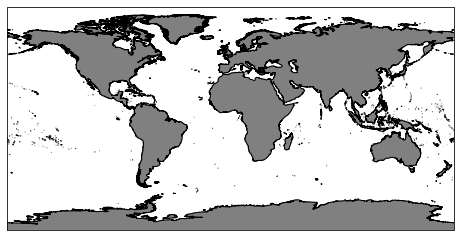

In [123]:
# Extract a specific time 'slice' of data
t = track_data

# Create a figure object
fig = plt.figure(figsize=(8, 6))

# Generate axes, using Cartopy, drawing coastlines, and adding features
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)

ax.coastlines("10m")
ax.add_feature(cfeature.LAND.with_scale("10m"), facecolor="gray")

# Contourf-plot data
temp = plt.contour(track_data(["Lat"],["Lon"]), track_data["048hT01"],
                      transform=proj, # What our reference system is (lat and long)
                      levels=25,
                      vmin=14.9,
                      vmax=17.3,
                      cmap='magma', # Using best practices when choosing a colormap color scheme 
                   add_colorbar=False)

cbar_ticks = np.arange(15, 17.3, 0.3)
cbar =  t.plot.colorbar(temp,
                    orientation='horizontal',
                    shrink=0.8,
                    pad=0.073,
                    extendrect=True,
                    ticks=cbar_ticks)

cbar.ax.tick_params(labelsize=10)

# Add a title to the map projection
plt.title('Strait of Gibraltar', x=.5, y=1.07, fontsize=15)
plt.show()


# Now try with the other two resolutions '50m' and '110m'

# Plot 

## Plotting On Map

In [46]:
#MY OWN PLOT CODE

def track_data_plot():
    lat, lon = track_data["Lat"], track_data["Lon"]
    # z=track_data  #doesn't change anything yet
    
    # Create a figure object
    fig = plt.figure(figsize=(8, 6))
    
    # Generate axes, using Cartopy, drawing coastlines, and adding features
    proj = ccrs.PlateCarree()
    ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)
    
    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.OCEAN)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.coastlines()
    ax.set_global() #zooms out to the whole world instead of in on the data
    ax.gridlines()
    # ax.stock_img() #dont ned rn
    plt.scatter(lon, lat, transform=ccrs.PlateCarree(), \
        label=None, linewidth=0, alpha=0.5
        )
    
    plt.xlabel('lon')
    plt.ylabel('lat')
    # plt.colorbar(label='')
    # plt.clim(0, 10) #Is the ticks of the color bar on the side. Change to what you want when you need
    # ax.set_extent() #sets the bounds of the plot
track_data_plot()

NameError: name 'ccrs' is not defined

<Figure size 576x432 with 0 Axes>

/glade/u/apps/opt/conda/envs/npl/lib/python3.7/site-packages/ipykernel_launcher.py:24: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "figsize" which is no longer supported as of 3.3 and will become an error in 3.6


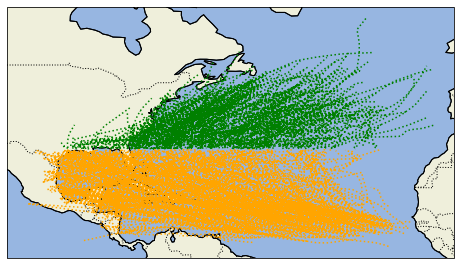

In [308]:
#Second Try: my code

# plt.figure(dpi=1200)
lat, lon = track_data["Lat"], track_data["Lon"]
lat_n= lat.where(30<lat)
lat_s= lat.where(30>lat)
# Create a figure object
fig = plt.figure(figsize=(8, 6))
    
    # Generate axes, using Cartopy, drawing coastlines, and adding features
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)
    
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.coastlines()
# ax.set_global() #zooms out to the whole world instead of in on the data
# ax.gridlines()

ax.plot(lon, lat_n, linestyle=':', color='green', transform=ccrs.PlateCarree())
ax.plot(lon, lat_s, linestyle=':', color='orange', transform=ccrs.PlateCarree())
fig.savefig('spatialmap2.png', figsize=(8,6))


# Errors

The idea will be to group forecasts together in specific regions (e.g., Gulf of Mexico, Caribbean, Eastern Atlantic, and Subtropics) by the latitude and longitude.

As a first step, I suggest to divide the data by latitude, so first you only keep the data south of a certain latitude, for example 30 deg N. 

Then you plot the track error and intensity error plots, but only the "filtered" data, that is, the data south of 30 deg N. 

Then you repeat the plots with data north of 30 deg N. We call the process of only using a subset of the entire dataset "filtering".

You know you're doing the right thing when you plot the map plot that you showed above and it only shows datapoints in the specified region (south of 30 deg N in my example).


## Track

### South of 30 Degrees

#### Mean

In [9]:
#South of 30 degrees 
track000S=track_data["000hT01"].where(30>track_data["Lat"]).mean()
track024S=track_data["024hT01"].loc[(30>track_data["Lat"])].mean()
track048S=track_data["048hT01"].loc[(30>track_data["Lat"])].mean()
track072S=track_data["072hT01"].loc[(30>track_data["Lat"])].mean()
track096S=track_data["096hT01"].loc[(30>track_data["Lat"])].mean()
track120S=track_data["120hT01"].loc[(30>track_data["Lat"])].mean()
track144S=track_data["144hT01"].loc[(30>track_data["Lat"])].mean()
# Note brackets surrounding each condition and how each has to be seperated out


print(track000S)
print(track024S)
print(track048S)
print(track072S)
print(track096S)
print(track120S)
print(track144S)

#Sanity check to 0 hr
print("All track 00:", track_data["000hT01"].mean())
print("All track 24:", track_data["024hT01"].mean())
print("All track 48:", track_data["048hT01"].mean())
print("All track 72:", track_data["072hT01"].mean())
print("All track 96:", track_data["096hT01"].mean())
print("All track 120:",track_data["120hT01"].mean())

11.047489036638867
67.50397984886642
130.24190845933805
196.33288810483901
166.22333540759178
218.06948102246344
nan
All track 00: 11.425600302514683
All track 24: 74.2145535392383
All track 48: 141.73688254665217
All track 72: 210.12652519893948
All track 96: 171.03251468232742
All track 120: 226.52122448979608


In [10]:
#List
track_mean_S= [track000S, track024S, track048S, track072S, track096S, track120S]
track_mean_S

[11.047489036638867,
 67.50397984886642,
 130.24190845933805,
 196.33288810483901,
 166.22333540759178,
 218.06948102246344]

In [ ]:
xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]

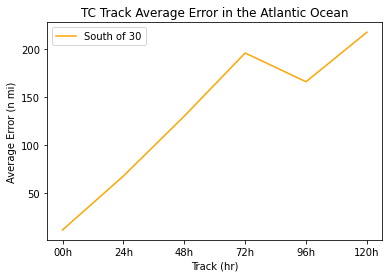

In [18]:
#Plotting Means North of 30 degrees + South of 30 Degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_mean_S, color="orange", label="South of 30")

plt.title('TC Track Average Error in the Atlantic Ocean')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()
plt.show()


#### STD

In [466]:
#North of 30 degrees 
std_track000S=track_data["000hT01"].where(30>track_data["Lat"]).std()
std_track024S=track_data["024hT01"].loc[(30>track_data["Lat"])].std()
std_track048S=track_data["048hT01"].loc[(30>track_data["Lat"])].std()
std_track072S=track_data["072hT01"].loc[(30>track_data["Lat"])].std()
std_track096S=track_data["096hT01"].loc[(30>track_data["Lat"])].std()
std_track120S=track_data["120hT01"].loc[(30>track_data["Lat"])].std()
std_track144S=track_data["144hT01"].loc[(30>track_data["Lat"])].std()
# Note brackets surrounding each condition and how each has to be seperated out


print(track000S)
print(track024S)
print(track048S)
print(track072S)
print(track096S)
print(track120S)
print(track144S)

#Sanity check to 0 hr
print("All track 00:", track_data["000hT01"].std())
print("All track 24:", track_data["024hT01"].std())
print("All track 48:", track_data["048hT01"].std())
print("All track 72:", track_data["072hT01"].std())
print("All track 96:", track_data["096hT01"].std())
print("All track 120:",track_data["120hT01"].std())

12.855913047042456
51.05736818947486
105.77366918811245
159.18892649190812
114.97361892145855
148.5548721150212
nan
All track 00: 14.280432299530196
All track 24: 59.613265483300516
All track 48: 119.87772843598813
All track 72: 179.88514378184007
All track 96: 119.33063318338941
All track 120: 154.53436279264128


In [8]:
#List
track_std_S= [std_track000S, std_track024S, std_track048S, std_track072S, std_track096S, std_track120S]
track_std_S

NameError: name 'std_track000S' is not defined

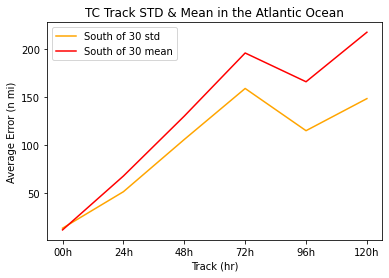

In [490]:
#Plotting Means North of 30 degrees + South of 30 Degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_std_S, color="orange", label="South of 30 std")
plt.plot(xlabels, track_mean_S, color="red", label="South of 30 mean")

plt.title('TC Track STD & Mean in the Atlantic Ocean')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()


### North of 30 Degrees 

#### Mean

In [13]:
#North of 30 degrees 
track000_N=track_data["000hT01"].loc[(30<track_data["Lat"])].mean()
track024_N=track_data["024hT01"].loc[(30<track_data["Lat"])].mean()
track048_N=track_data["048hT01"].loc[(30<track_data["Lat"])].mean()
track072_N=track_data["072hT01"].loc[(30<track_data["Lat"])].mean()
track096_N=track_data["096hT01"].loc[(30<track_data["Lat"])].mean()
track120_N=track_data["120hT01"].loc[(30<track_data["Lat"])].mean()
track144_N=track_data["144hT01"].loc[(30<track_data["Lat"])].mean()
# Note brackets surrounding each condition and how each has to be seperated out


print(track000_N)
print(track024_N)
print(track048_N)
print(track072_N)
print(track096_N)
print(track120_N)
print(track144_N)

#Sanity check to 0 hr
print("All track 00:", track_data["000hT01"].mean())
print("All track 24:", track_data["024hT01"].mean())
print("All track 48:", track_data["048hT01"].mean())
print("All track 72:", track_data["072hT01"].mean())
print("All track 96:", track_data["096hT01"].mean())
print("All track 120:",track_data["120hT01"].mean())

12.221403812824988
91.08274678111604
179.4026841018582
267.3996721311475
198.75325670498083
285.95828571428575
nan
All track 00: 11.425600302514683
All track 24: 74.2145535392383
All track 48: 141.73688254665217
All track 72: 210.12652519893948
All track 96: 171.03251468232742
All track 120: 226.52122448979608


In [14]:
#List
track_mean_N= [track000_N, track024_N, track048_N, track072_N, track096_N, track120_N]
track_mean_N

[12.221403812824988,
 91.08274678111604,
 179.4026841018582,
 267.3996721311475,
 198.75325670498083,
 285.95828571428575]

In [16]:
xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


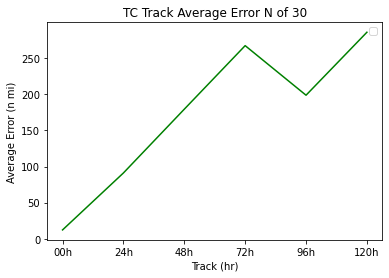

In [17]:
#Plotting Means South of 30 degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_mean_N,  color="green")

plt.title('TC Track Average Error N of 30')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()
plt.show()

#### STD

In [144]:
#North of 30 degrees 
std_track000_N=track_data["000hT01"].loc[(30<track_data["Lat"])].std()
std_track024_N=track_data["024hT01"].loc[(30<track_data["Lat"])].std()
std_track048_N=track_data["048hT01"].loc[(30<track_data["Lat"])].std()
std_track072_N=track_data["072hT01"].loc[(30<track_data["Lat"])].std()
std_track096_N=track_data["096hT01"].loc[(30<track_data["Lat"])].std()
std_track120_N=track_data["120hT01"].loc[(30<track_data["Lat"])].std()
std_track144_N=track_data["144hT01"].loc[(30<track_data["Lat"])].std()
# Note brackets surrounding each condition and how each has to be seperated out


print(std_track000_N)
print(std_track024_N)
print(std_track048_N)
print(std_track072_N)
print(std_track096_N)
print(track120_N)
print(std_track144_N)

#Sanity check to 0 hr
print("All track 00:", track_data["000hT01"].std())
print("All track 24:", track_data["024hT01"].std())
print("All track 48:", track_data["048hT01"].std())
print("All track 72:", track_data["072hT01"].std())
print("All track 96:", track_data["096hT01"].std())
print("All track 120:",track_data["120hT01"].std())

16.81961974003019
74.68312509580025
151.99755045404612
240.41163370630917
138.52332002690434
285.95828571428575
nan
All track 00: 14.280432299530196
All track 24: 59.613265483300516
All track 48: 119.87772843598813
All track 72: 179.88514378184007
All track 96: 119.33063318338941
All track 120: 154.53436279264128


In [475]:
#List
track_std_N= [std_track000_N, std_track024_N, std_track048_N, std_track072_N, std_track096_N, std_track120_N]
track_std_N

[16.81961974003019,
 74.68312509580025,
 151.99755045404612,
 240.41163370630917,
 138.52332002690434,
 181.2117258119821]

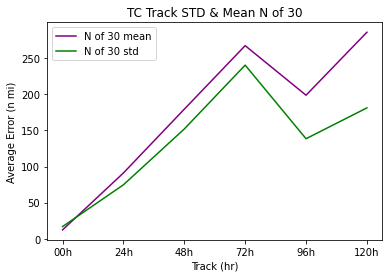

In [489]:
#Plotting Means South of 30 degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_mean_N,  color="purple", label="N of 30 mean")
plt.plot(xlabels, track_std_N,  color="green", label="N of 30 std")

plt.title('TC Track STD & Mean N of 30')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()

In [39]:
# T test statistic ?
st.t.cdf(x=-0.76, df=12) 

# this is the amount that we would see the p value (-.76) or the extreme value 
# in the data so its 23% of the time

0.23096277420544897

## Seperating dataset by N + S and forecast hours

In [125]:
#South of 30 degrees 
S_000=track_data["000hT01"].loc[(30>track_data["Lat"])]
S_024=track_data["024hT01"].loc[(30>track_data["Lat"])]
S_048=track_data["048hT01"].loc[(30>track_data["Lat"])]
S_072=track_data["072hT01"].loc[(30>track_data["Lat"])]
S_096=track_data["096hT01"].loc[(30>track_data["Lat"])]
S_120=track_data["120hT01"].loc[(30>track_data["Lat"])]
S_144=track_data["144hT01"].loc[(30>track_data["Lat"])]

#South of 30 degrees
N_000=track_data["000hT01"].loc[(30<track_data["Lat"])]
N_024=track_data["024hT01"].loc[(30<track_data["Lat"])]
N_048=track_data["048hT01"].loc[(30<track_data["Lat"])]
N_072=track_data["072hT01"].loc[(30<track_data["Lat"])]
N_096=track_data["096hT01"].loc[(30<track_data["Lat"])]
N_120=track_data["120hT01"].loc[(30<track_data["Lat"])]
N_144=track_data["144hT01"].loc[(30<track_data["Lat"])]

In [126]:
S_000=S_000[pd.notnull(S_000)]
S_024=S_024[pd.notnull(S_024)]
S_048=S_048[pd.notnull(S_048)]
S_072=S_072[pd.notnull(S_072)]
S_096=S_096[pd.notnull(S_096)]
S_120=S_120[pd.notnull(S_120)]
S_144=S_144[pd.notnull(S_144)]

N_000=N_000[pd.notnull(N_000)]
N_024=N_024[pd.notnull(N_024)]
N_048=N_048[pd.notnull(N_048)]
N_072=N_072[pd.notnull(N_072)]
N_096=N_096[pd.notnull(N_096)]
N_120=N_120[pd.notnull(N_120)]
N_144=N_144[pd.notnull(N_144)]

In [103]:
# pd.set_option('display.max_rows', None)
N_000[pd.notnull(N_000)]

68        38.9
69        23.8
70        62.8
71        15.1
72        12.8
73        18.0
74         6.0
76         7.8
77        15.4
78         7.7
79        11.2
80         9.2
81        12.8
82         0.0
83        12.8
84         0.0
85        14.0
93        12.0
94        13.0
95        19.1
96        34.1
97        33.1
98        18.1
156       31.6
157       23.6
166        7.9
167       15.4
168       27.2
169       23.6
170       27.0
171       18.7
172       76.2
173       88.1
174       26.9
175       66.0
176       60.7
177       89.1
178        7.8
179       20.2
180       13.0
181       19.3
182       10.1
183       31.0
184       18.0
185       12.0
186       13.0
187       18.0
188       13.0
189       18.7
190       45.7
191       20.7
192       41.4
193       89.6
194        5.1
195       33.1
196       43.2
197       39.1
198       30.6
199       36.2
200       11.8
201       66.4
202       25.6
203       16.5
204       10.3
205       16.5
206        6.0
207       

In [95]:
N_048[pd.notnull(N_048)]

76       210.3
77        27.8
166      255.0
167      103.1
168      197.8
169      186.6
170      257.7
171      302.4
172      937.1
173      927.3
174      779.8
175      685.6
176      710.9
177      382.5
178      298.5
179      162.0
180      138.9
181      133.3
182      151.6
183      195.2
184      156.1
185      137.0
186      186.3
187      220.8
188      204.4
189      243.6
190      244.5
191       74.0
192       31.2
193       24.0
194      291.6
195      191.4
196      338.8
197      502.0
198      333.1
199      323.9
200      393.1
201      350.8
202      206.3
203      216.5
204      251.4
205       57.2
206       60.0
207       75.3
208      192.3
209      238.5
210      246.0
211      288.7
212      299.6
232      227.7
233       76.0
234      297.8
245      177.4
344      510.9
345      553.8
346      347.3
347      396.4
348      360.5
349      394.4
350      384.1
351      546.8
352      452.4
353      293.3
354      623.7
355      713.6
367       67.4
368      1

## Plot of Both N and S

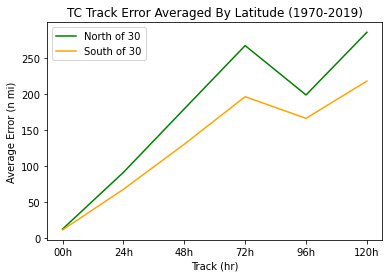

In [263]:
#Plotting Means North of 30 degrees + South of 30 Degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_mean_N,  color="green", label="North of 30")
plt.plot(xlabels, track_mean_S, color="orange", label="South of 30")

plt.title('TC Track Error Averaged By Latitude (1970-2019)')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()



The standard deviation for North and South respectively are lower than the mean. 
So this confirms that the data is fairly evenly clustered so the mean counts for something.

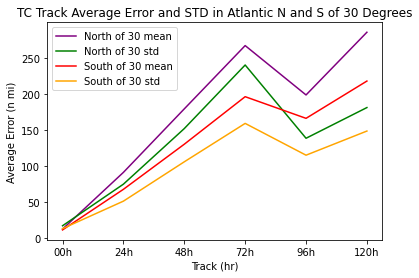

In [486]:
#Plotting Both mean/STD of both North & South of 30 degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_mean_N,  color="purple", label="North of 30 mean")
plt.plot(xlabels, track_std_N,  color="green", label="North of 30 std")
plt.plot(xlabels, track_mean_S, color="red", label="South of 30 mean")
plt.plot(xlabels, track_std_S, color="orange", label="South of 30 std")


plt.title('TC Track Average Error and STD in Atlantic N and S of 30 Degrees')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()


## Intensity 

### South

#### Mean

In [205]:
#South of 30 degrees 
int000S=int_data["000hI01"].loc[(30>int_data["Lat"])].mean()
int024S=int_data["024hI01"].loc[(30>int_data["Lat"])].mean()
int048S=int_data["048hI01"].loc[(30>int_data["Lat"])].mean()
int072S=int_data["072hI01"].loc[(30>int_data["Lat"])].mean()
int096S=int_data["096hI01"].loc[(30>int_data["Lat"])].mean()
int120S=int_data["120hI01"].loc[(30>int_data["Lat"])].mean()
int144S=int_data["144hI01"].loc[(30>int_data["Lat"])].mean()
# Note brackets surrounding each condition and how each has to be seperated out


print(int000S)
print(int024S)
print(int048S)
print(int072S)
print(int096S)
print(int120S)
print(int144S)

#Sanity check to 0 hr
print("All track 00:", int_data["000hI01"].mean())
print("All track 24:", int_data["024hI01"].mean())
print("All track 48:", int_data["048hI01"].mean())
print("All track 72:", int_data["072hI01"].mean())
print("All track 96:", int_data["096hI01"].mean())
print("All track 120:",int_data["120hI01"].mean())

2.671527388296878
10.78455375027821
15.414673046251993
17.65220207253886
16.801493466085873
17.982184353214564
nan
All track 00: 2.5783769836150174
All track 24: 10.113429375724458
All track 48: 14.670411191182705
All track 72: 17.02409964798267
All track 96: 16.169247197010144
All track 120: 17.4421768707483


In [201]:
#List
int_mean_S= [int000S, int024S, int048S, int072S, int096S, int120S]
int_mean_S

[2.671527388296878,
 10.78455375027821,
 15.414673046251993,
 17.65220207253886,
 16.801493466085873,
 17.982184353214564]

In [202]:
xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]

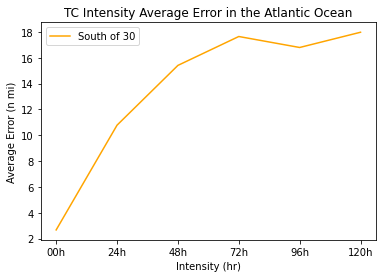

In [203]:
#Plotting Means North of 30 degrees + South of 30 Degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, int_mean_S, color="orange", label="South of 30")

plt.title('TC Intensity Average Error in the Atlantic Ocean')
plt.xlabel("Intensity (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()
plt.show()

#### STD

In [208]:
#South of 30 degrees 
std_int000S=int_data["000hI01"].where(30>int_data["Lat"]).std()
std_int024S=int_data["024hI01"].loc[(30>int_data["Lat"])].std()
std_int048S=int_data["048hI01"].loc[(30>int_data["Lat"])].std()
std_int072S=int_data["072hI01"].loc[(30>int_data["Lat"])].std()
std_int096S=int_data["096hI01"].loc[(30>int_data["Lat"])].std()
std_int120S=int_data["120hI01"].loc[(30>int_data["Lat"])].std()
std_int144S=int_data["144hI01"].loc[(30>int_data["Lat"])].std()
# Note brackets surrounding each condition and how each has to be seperated out


print(std_int000S)
print(std_int024S)
print(std_int048S)
print(std_int072S)
print(std_int096S)
print(std_int120S)
print(std_int144S)

#Sanity check to 0 hr
print("All track 00:", int_data["000hI01"].std())
print("All track 24:", int_data["024hI01"].std())
print("All track 48:", int_data["048hI01"].std())
print("All track 72:", int_data["072hI01"].std())
print("All track 96:", int_data["096hI01"].std())
print("All track 120:",int_data["120hI01"].std())

3.912703779243394
9.614213006031472
12.732841863117299
14.644900195128447
14.293439533869906
15.633114085175086
nan
All track 00: 3.809938378681426
All track 24: 9.152541344540914
All track 48: 12.267878616529735
All track 72: 14.24085549028424
All track 96: 13.882699770045114
All track 120: 15.169399373563564


In [209]:
#List
int_std_S= [std_int000S, std_int024S, std_int048S, std_int072S, std_int096S, std_int120S]
int_std_S

[3.912703779243394,
 9.614213006031472,
 12.732841863117299,
 14.644900195128447,
 14.293439533869906,
 15.633114085175086]

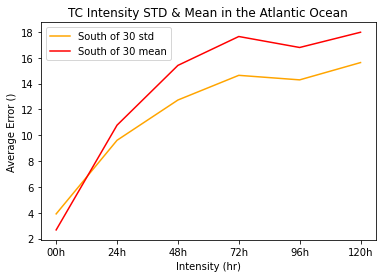

In [211]:
#Plotting Means North of 30 degrees + South of 30 Degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, int_std_S, color="orange", label="South of 30 std")
plt.plot(xlabels, int_mean_S, color="red", label="South of 30 mean")

plt.title('TC Intensity STD & Mean in the Atlantic Ocean')
plt.xlabel("Intensity (hr)")
plt.ylabel("Average Error ()")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()



### North

#### Mean

In [213]:
#North of 30 degrees 
int000_N=int_data["000hI01"].loc[(30<int_data["Lat"])].mean()
int024_N=int_data["024hI01"].loc[(30<int_data["Lat"])].mean()
int048_N=int_data["048hI01"].loc[(30<int_data["Lat"])].mean()
int072_N=int_data["072hI01"].loc[(30<int_data["Lat"])].mean()
int096_N=int_data["096hI01"].loc[(30<int_data["Lat"])].mean()
int120_N=int_data["120hI01"].loc[(30<int_data["Lat"])].mean()
int144_N=int_data["144hI01"].loc[(30<int_data["Lat"])].mean()
# Note brackets surrounding each condition and how each has to be seperated out


print(int000_N)
print(int024_N)
print(int048_N)
print(int072_N)
print(int096_N)
print(int120_N)
print(int144_N)

#Sanity check to 0 hr
print("All track 00:", int_data["000hI01"].mean())
print("All track 24:", int_data["024hI01"].mean())
print("All track 48:", int_data["048hI01"].mean())
print("All track 72:", int_data["072hI01"].mean())
print("All track 96:", int_data["096hI01"].mean())
print("All track 120:",int_data["120hI01"].mean())

2.3575348248205996
8.150459921156374
11.684491978609625
13.625632377740304
12.164750957854405
13.314285714285715
nan
All track 00: 2.5783769836150174
All track 24: 10.113429375724458
All track 48: 14.670411191182705
All track 72: 17.02409964798267
All track 96: 16.169247197010144
All track 120: 17.4421768707483


In [215]:
#List
int_mean_N= [int000_N, int024_N, int048_N, int072_N, int096_N, int120_N]
int_mean_N

[2.3575348248205996,
 8.150459921156374,
 11.684491978609625,
 13.625632377740304,
 12.164750957854405,
 13.314285714285715]

In [214]:
xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


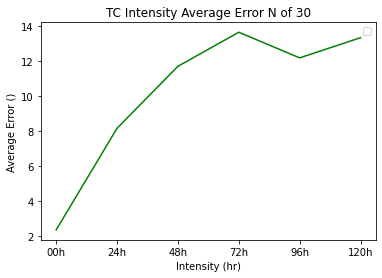

In [217]:
#Plotting Means South of 30 degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, int_mean_N,  color="green")

plt.title('TC Intensity Average Error N of 30')
plt.xlabel("Intensity (hr)")
plt.ylabel("Average Error ()")
plt.legend()
plt.show()

#### STD

In [218]:
#North of 30 degrees 
std_int000_N=int_data["000hI01"].loc[(30<int_data["Lat"])].std()
std_int024_N=int_data["024hI01"].loc[(30<int_data["Lat"])].std()
std_int048_N=int_data["048hI01"].loc[(30<int_data["Lat"])].std()
std_int072_N=int_data["072hI01"].loc[(30<int_data["Lat"])].std()
std_int096_N=int_data["096hI01"].loc[(30<int_data["Lat"])].std()
std_int120_N=int_data["120hI01"].loc[(30<int_data["Lat"])].std()
std_int144_N=int_data["144hI01"].loc[(30<int_data["Lat"])].std()
# Note brackets surrounding each condition and how each has to be seperated out


print(std_int000_N)
print(std_int024_N)
print(std_int048_N)
print(std_int072_N)
print(std_int096_N)
print(std_int120_N)
print(std_int144_N)

#Sanity check to 0 hr
print("All int 00:", int_data["000hI01"].std())
print("All int 24:", int_data["024hI01"].std())
print("All int 48:", int_data["048hI01"].std())
print("All int 72:", int_data["072hI01"].std())
print("All int 96:", int_data["096hI01"].std())
print("All int 120:",int_data["120hI01"].std())

3.5509187050782267
7.3051522656251695
9.716094350946731
11.34195827655254
10.24731028664676
10.388353969410181
nan
All int 00: 3.809938378681426
All int 24: 9.152541344540914
All int 48: 12.267878616529735
All int 72: 14.24085549028424
All int 96: 13.882699770045114
All int 120: 15.169399373563564


In [219]:
#List
int_std_N= [std_int000_N, std_int024_N, std_int048_N, std_int072_N, std_int096_N, std_int120_N]
int_std_N

[3.5509187050782267,
 7.3051522656251695,
 9.716094350946731,
 11.34195827655254,
 10.24731028664676,
 10.388353969410181]

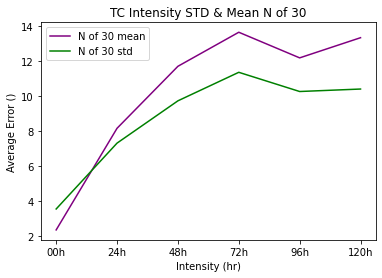

In [220]:
#Plotting Means South of 30 degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, int_mean_N,  color="purple", label="N of 30 mean")
plt.plot(xlabels, int_std_N,  color="green", label="N of 30 std")

plt.title('TC Intensity STD & Mean N of 30')
plt.xlabel("Intensity (hr)")
plt.ylabel("Average Error ()")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()

### Plot of both N & S

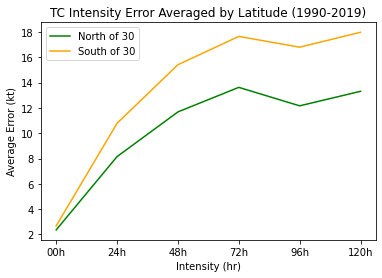

In [262]:
#Plotting Means North of 30 degrees + South of 30 Degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, int_mean_N,  color="green", label="North of 30")
plt.plot(xlabels, int_mean_S, color="orange", label="South of 30")

plt.title('TC Intensity Error Averaged by Latitude (1990-2019)')
plt.xlabel("Intensity (hr)")
plt.ylabel("Average Error (kt)")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()



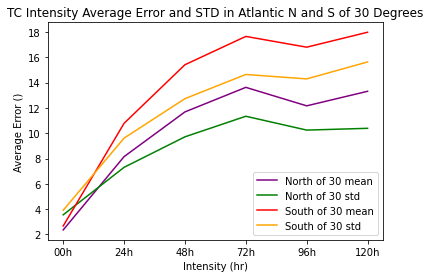

In [222]:
#Plotting Both mean/STD of both North & South of 30 degrees

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, int_mean_N,  color="purple", label="North of 30 mean")
plt.plot(xlabels, int_std_N,  color="green", label="North of 30 std")
plt.plot(xlabels, int_mean_S, color="red", label="South of 30 mean")
plt.plot(xlabels, int_std_S, color="orange", label="South of 30 std")


plt.title('TC Intensity Average Error and STD in Atlantic N and S of 30 Degrees')
plt.xlabel("Intensity (hr)")
plt.ylabel("Average Error ()")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()

## Statistical Analysis

### Track

In [143]:
import numpy as np
import scipy.stats as st
rng = np.random.default_rng()

#Two sample t-test

st.ttest_ind(N_000, S_000, axis=0, equal_var=True, nan_policy='omit') 

# nan_policy will take out nan values
#If True (default), perform a standard independent 2 sample test that assumes equal population variances

Ttest_indResult(statistic=3.9627250689535165, pvalue=7.458818860120533e-05)

TTest uses pyramid shaped data. st.mannwhitneyu() uses not normal or gaussian shaped data for statistics 

#### 00h

In [161]:
st.mannwhitneyu(S_000, N_000)

MannwhitneyuResult(statistic=12415460.5, pvalue=0.21762272200404087)

#### 24h

In [163]:
st.mannwhitneyu(S_024, N_024)

#Smallest p-value out of all forecast hours

MannwhitneyuResult(statistic=5759415.0, pvalue=2.281535190006746e-33)

#### 48h

In [164]:
st.mannwhitneyu(S_048, N_048)

#SECOND Smallest p-value

MannwhitneyuResult(statistic=2933458.0, pvalue=3.599199185029463e-24)

#### 72h

In [165]:
st.mannwhitneyu(S_072, N_072)

# THIRD Smallest --value

MannwhitneyuResult(statistic=1544533.0, pvalue=1.85102296806454e-12)

#### 96h

In [169]:
st.mannwhitneyu(S_096, N_096)

#LARGEST P-value

MannwhitneyuResult(statistic=184288.0, pvalue=0.0016568332871837856)

In [269]:
print(st.mannwhitneyu(S_000, N_000))
print(st.mannwhitneyu(S_024, N_024))
print(st.mannwhitneyu(S_048, N_048))
print(st.mannwhitneyu(S_072, N_072))
print(st.mannwhitneyu(S_096, N_096))
print(st.mannwhitneyu(S_120, N_120))

MannwhitneyuResult(statistic=12415460.5, pvalue=0.21762272200404087)
MannwhitneyuResult(statistic=5759415.0, pvalue=2.281535190006746e-33)
MannwhitneyuResult(statistic=2933458.0, pvalue=3.599199185029463e-24)
MannwhitneyuResult(statistic=1544533.0, pvalue=1.85102296806454e-12)
MannwhitneyuResult(statistic=184288.0, pvalue=0.0016568332871837856)
MannwhitneyuResult(statistic=84042.5, pvalue=3.737904960956929e-08)


#### 120h

In [168]:
st.mannwhitneyu(S_120, N_120)

MannwhitneyuResult(statistic=84042.5, pvalue=3.737904960956929e-08)

#### 144h = NaN

In [171]:
st.ttest_ind(S_144, N_144, equal_var=True)

Ttest_indResult(statistic=nan, pvalue=nan)

The statistic is the 'T" statistic. How much the sample mean deviates from the population (or another sample- <b>"Two sample t-test"</b>) or null hyp. mean
^ If t statistic is extreme enough (outside of the quantile) then we can accept the alternative hypothesis (that there is significance)
But the p-value tells the probability you would see the result due to chance

If we want a 95% confidence than we need a p-value that is 5% or lower to accept the evidence that the p value .046 happens 46% of the time 

#### This means that because the p-value is greater than the 5% significance for the 95% conf interval, we have to reject the alternate hypothesis.

Text(0, 0.5, 'occurances')

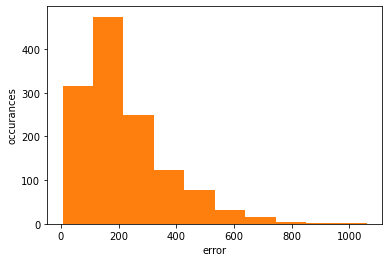

In [170]:
# Histogram to see the shape of the data

plt.hist(N_120)
plt.hist(S_120)
plt.xlabel("error") #
plt.ylabel("occurances")

Text(0, 0.5, 'occurances')

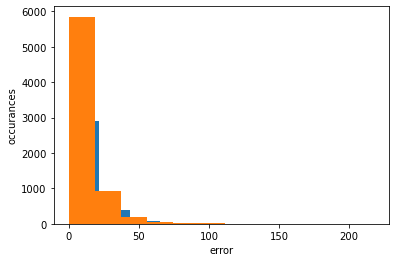

In [155]:
plt.hist(N_000)
plt.hist(S_000)
plt.xlabel("error")
plt.ylabel("occurances")

### Intensity

In [278]:
# Seperate data into forecast hour

#South of 30 degrees 
intS_000=int_data["000hI01"].loc[(30>int_data["Lat"])]
intS_024=int_data["024hI01"].loc[(30>int_data["Lat"])]
intS_048=int_data["048hI01"].loc[(30>int_data["Lat"])]
intS_072=int_data["072hI01"].loc[(30>int_data["Lat"])]
intS_096=int_data["096hI01"].loc[(30>int_data["Lat"])]
intS_120=int_data["120hI01"].loc[(30>int_data["Lat"])]
intS_144=int_data["144hI01"].loc[(30>int_data["Lat"])]

#South of 30 degrees
intN_000=int_data["000hI01"].loc[(30<int_data["Lat"])]
intN_024=int_data["024hI01"].loc[(30<int_data["Lat"])]
intN_048=int_data["048hI01"].loc[(30<int_data["Lat"])]
intN_072=int_data["072hI01"].loc[(30<int_data["Lat"])]
intN_096=int_data["096hI01"].loc[(30<int_data["Lat"])]
intN_120=int_data["120hI01"].loc[(30<int_data["Lat"])]
intN_144=int_data["144hI01"].loc[(30<int_data["Lat"])]

In [279]:
#Foreget the NaNs
intS_000=intS_000[pd.notnull(intS_000)]
intS_024=intS_024[pd.notnull(intS_024)]
intS_048=intS_048[pd.notnull(intS_048)]
intS_072=intS_072[pd.notnull(intS_072)]
intS_096=intS_096[pd.notnull(intS_096)]
intS_120=intS_120[pd.notnull(intS_120)]
intS_144=intS_144[pd.notnull(intS_144)]

intN_000=intN_000[pd.notnull(intN_000)]
intN_024=intN_024[pd.notnull(intN_024)]
intN_048=intN_048[pd.notnull(intN_048)]
intN_072=intN_072[pd.notnull(intN_072)]
intN_096=intN_096[pd.notnull(intN_096)]
intN_120=intN_120[pd.notnull(intN_120)]
intN_144=intN_144[pd.notnull(intN_144)]

In [280]:
import numpy as np
import scipy.stats as st
rng = np.random.default_rng()

#Two sample t-test

print(st.mannwhitneyu(intN_000, intS_000))
print(st.mannwhitneyu(intN_024, intS_024))
print(st.mannwhitneyu(intN_048, intS_048))
print(st.mannwhitneyu(intN_072, intS_072))
print(st.mannwhitneyu(intN_096, intS_096))
print(st.mannwhitneyu(intN_120, intS_120))

MannwhitneyuResult(statistic=6080658.0, pvalue=0.00110557154518439)
MannwhitneyuResult(statistic=2906904.0, pvalue=3.1923258982247936e-19)
MannwhitneyuResult(statistic=1470412.5, pvalue=3.582957037667638e-15)
MannwhitneyuResult(statistic=779842.5, pvalue=7.423309672265674e-09)
MannwhitneyuResult(statistic=171379.5, pvalue=1.6276671645284507e-06)
MannwhitneyuResult(statistic=95608.0, pvalue=0.0008510874582542848)


## Gulf of Mexico Mean

In [383]:
#Sanity check to 0 hr
print("All track 00:", track_data["000hT01"].mean())
print("All track 24:", track_data["024hT01"].mean())
print("All track 48:", track_data["048hT01"].mean())
print("All track 72:", track_data["072hT01"].mean())
print("All track 96:", track_data["096hT01"].mean())
print("All track 120:",track_data["120hT01"].mean())




#Using only gulf of mexico to get mean of forecast hours
track000=track_data["000hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
track024=track_data["024hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
track048=track_data["048hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
track072=track_data["072hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
track096=track_data["096hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
track120=track_data["120hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
track144=track_data["144hT01"].loc[(-100< track_data["Lon"]) & (-80>track_data["Lon"]) & (18< track_data["Lat"]) & (30>track_data["Lat"])].mean()
# Note brackets surrounding each condition and how each has to be seperated out


print(track0)
print(track24)
print(track48)
print(track72)
print(track96)
print(track120)
print(track144)

All track 00: 11.425600302514683
All track 24: 74.2145535392383
All track 48: 141.73688254665217
All track 72: 210.12652519893948
All track 96: 171.03251468232742
All track 120: 226.52122448979608
9.65914972273571
69.27128116938948
149.6402031930334
238.6219321148828
203.6134146341463
263.4783783783784
nan


In [390]:
#
track_mean= [track0, track24, track48, track72, track96, track120]
track_mean

[9.65914972273571,
 69.27128116938948,
 149.6402031930334,
 238.6219321148828,
 203.6134146341463,
 263.4783783783784]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


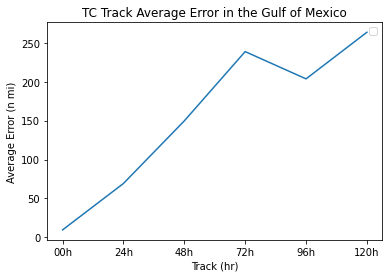

In [402]:
#Plotting Means in Gulf of Mexico

import matplotlib.pyplot as plt
import numpy as np
from random import random

plt.plot(xlabels, track_mean)

plt.title('TC Track Average Error in the Gulf of Mexico')
plt.xlabel("Track (hr)")
plt.ylabel("Average Error (n mi)")
plt.legend()

xlabels=["00h", "24h", "48h", "72h", "96h", "120h"]
plt.show()

## Coordinates by Region

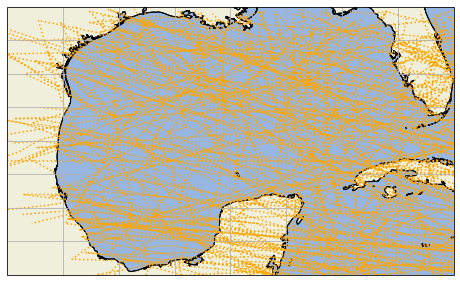

In [270]:
# Gulf of Mexico
# Plotting errors with cordinates x, y, z 

lat, lon = track_data["Lat"], track_data["Lon"]
# Create a figure object
fig = plt.figure(figsize=(8, 6))

# Generate axes, using Cartopy, drawing coastlines, and adding features
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
# ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.coastlines()
# ax.set_global() #zooms out to the whole world instead of in on the data
ax.gridlines()
ax.set_extent((-100, -80, 18, 30), crs=ccrs.PlateCarree()) #gulf of mexico
# (x,y,z,s) x=left, y=right, z=down,s=up

ax.plot(lon, lat.where(lat<30), linestyle=':', color='orange', transform=ccrs.PlateCarree())


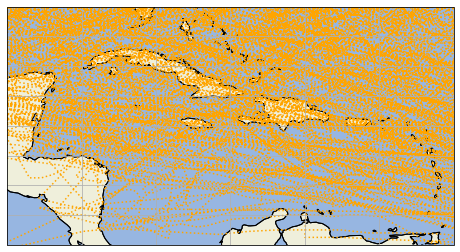

In [409]:
# Caribbean
# Plotting errors with cordinates x, y, z 

lat, lon = track_data["Lat"], track_data["Lon"]
# Create a figure object
fig = plt.figure(figsize=(8, 6))

# Generate axes, using Cartopy, drawing coastlines, and adding features
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
# ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.coastlines()
# ax.set_global() #zooms out to the whole world instead of in on the data
ax.gridlines()
ax.set_extent((-90, -60, 10, 26), crs=ccrs.PlateCarree()) #caribbean
# (x,y,z,s) x=left, y=right, z=down, s=up

ax.plot(lon, lat, linestyle=':', color='orange', transform=ccrs.PlateCarree())


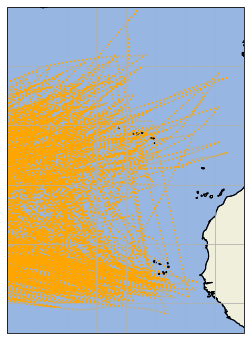

In [254]:
# East Atlantic
# Plotting errors with cordinates x, y, z 

lat, lon = track_data["Lat"], track_data["Lon"]
# Create a figure object
fig = plt.figure(figsize=(8, 6))

# Generate axes, using Cartopy, drawing coastlines, and adding features
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
# ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.coastlines()
# ax.set_global() #zooms out to the whole world instead of in on the data
ax.gridlines()
ax.set_extent((-50, -10, 5, 60), crs=ccrs.PlateCarree()) # east atl
# (x,y,z,s) x=left, y=right, z=down, s=up

ax.plot(lon, lat, linestyle=':', color='orange', transform=ccrs.PlateCarree())


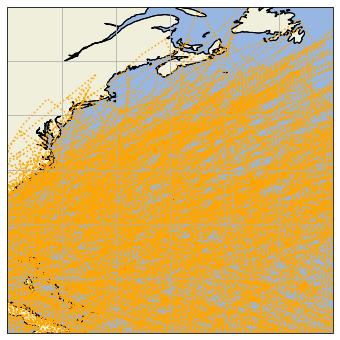

In [261]:
# West Atlantic
# Plotting errors with cordinates x, y, z 

lat, lon = track_data["Lat"], track_data["Lon"]
# Create a figure object
fig = plt.figure(figsize=(8, 6))

# Generate axes, using Cartopy, drawing coastlines, and adding features
proj = ccrs.PlateCarree()
ax = plt.axes(projection=proj)  #telling python what we want to see (PlateCarree)

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.COASTLINE)
# ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.coastlines()
# ax.set_global() #zooms out to the whole world instead of in on the data
ax.gridlines()
ax.set_extent((-80, -50, 20, 50), crs=ccrs.PlateCarree()) # east atl
# (x,y,z,s) x=left, y=right, z=down, s=up

ax.plot(lon, lat, linestyle=':', color='orange', transform=ccrs.PlateCarree())


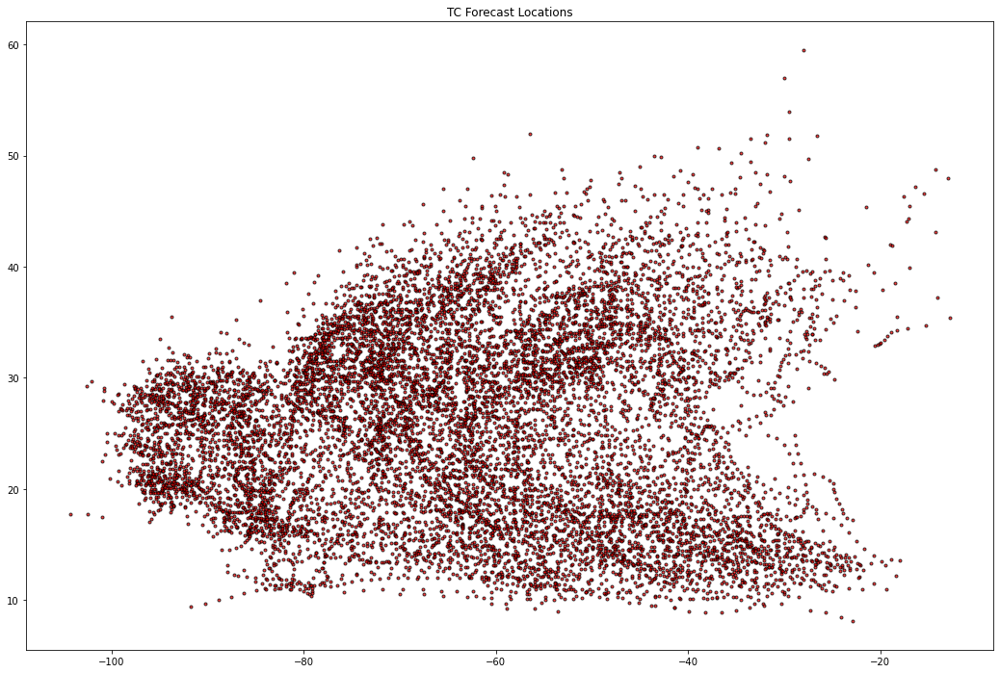

In [154]:
#scatter plot showing the locations (looks lke map because lat is y and loon is x)
fig = plt.figure(figsize=(18,12))
ax = plt.subplot(1,1,1)

ax.set_title ('TC Forecast Locations')
ax.scatter(lon,lat,s=9,c='r',edgecolor='black',alpha=0.75);